## Import Libraries

This dataset is depression dataset and emotion dataset combined.

In [1]:
#Loading libraries
import numpy as np # provides a high-performance multidimensional array and tools for its manipulation
import pandas as pd # for data munging, it contains manipulation tools designed to make data analysis fast and easy
import re # Regular Expressions - useful for extracting information from text 
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import classification_report
import nltk
from nltk.stem import PorterStemmer
from nltk.corpus import words
from nltk.corpus import stopwords
from nltk import word_tokenize
from sklearn.feature_extraction.text import TfidfVectorizer

import csv 
import os

# For viz
import seaborn as sns
%matplotlib inline

## Import CSV

In [2]:
# Read ____.csv file into a DataFrame
df = pd.read_csv("new_emotions.csv")
print(df.head())

                                                text  label
0  i feel awful about it too because it s my job ...      0
1                              im alone i feel awful      0
2  ive probably mentioned this before but i reall...      1
3           i was feeling a little low few days back      0
4  i beleive that i am much more sensitive to oth...      2


In [3]:
labels_count = df['label'].value_counts()
labels_count

1    141067
0    121187
3     57317
4     47712
2     34554
5     14972
6      3831
Name: label, dtype: int64

<AxesSubplot:xlabel='label', ylabel='count'>

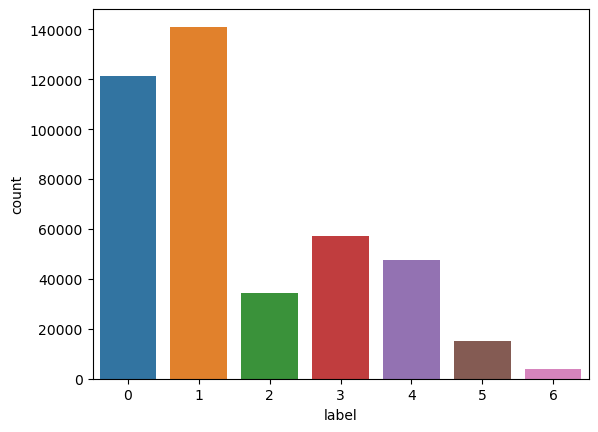

In [4]:
#df.label = df.label.replace({0: 'sadness', 1: 'joy', 2: 'love', 3: 'anger', 4: 'fear', 5: 'surprise', 6: 'depressed'})
sns.countplot(x=df['label'],data=df)

## Preprocessing
Here are some preprocessing steps:
* Removing noise:trailing whitespace etc.
* Removing punctuation
* Tokenization: split text into word tokens
* Stopword removal
* Stemming


In [5]:
df.isnull().sum()

text     0
label    0
dtype: int64

Split the dataset into train and test

In [6]:
#Split
x=df.text
y=df.label
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2)

#For later use
training_file = pd.DataFrame(x_train)
training_file['label'] = y_train
testing_file = pd.DataFrame(x_test)
testing_file['label'] = y_test

In [7]:
def preprocess_and_tokenize(x):    
    data = x.lower()
    #remove punctuation and non-ascii digits
    data = re.sub("(\\W|\\d)", " ", data)
    
    #remove whitespace
    data = data.strip()
    
    # tokenization with nltk
    data = word_tokenize(data)
    
    # stemming with nltk
    porter = PorterStemmer()
    stem_data = [porter.stem(word) for word in data]
        
    return stem_data

Vectorizing text using Term Frequency technique (Term Frequency(TF) — Inverse Dense Frequency(IDF))

In [8]:
# TFIDF, unigrams and bigrams
vect = TfidfVectorizer(tokenizer=preprocess_and_tokenize, sublinear_tf=True, norm='l2', ngram_range=(1, 2))

# fit on our complete corpus
vect.fit_transform(df.text)

# transform testing and training datasets to vectors
X_train_vect = vect.transform(x_train)
X_test_vect = vect.transform(x_test)

### Naive Bayes

In [9]:
nb = MultinomialNB()

nb.fit(X_train_vect, y_train)

ynb_pred = nb.predict(X_test_vect)

from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score

print("Accuracy: {:.2f}%".format(accuracy_score(y_test, ynb_pred) * 100))
print("F1 Score: {:.2f}%".format(f1_score(y_test, ynb_pred, average='weighted') * 100))
print("Precision: ",precision_score(y_test, ynb_pred, average='weighted')*100 )
print("Recall: ",recall_score(y_test, ynb_pred, average='weighted')*100)
print(classification_report(y_test, ynb_pred))

Accuracy: 65.38%
F1 Score: 57.42%
Precision:  75.82875731688922
Recall:  65.3753803727653
              precision    recall  f1-score   support

           0       0.71      0.91      0.80     24268
           1       0.59      0.99      0.74     28223
           2       1.00      0.04      0.08      6880
           3       0.94      0.26      0.40     11412
           4       0.90      0.18      0.30      9579
           5       1.00      0.01      0.03      3002
           6       1.00      0.01      0.01       764

    accuracy                           0.65     84128
   macro avg       0.88      0.34      0.34     84128
weighted avg       0.76      0.65      0.57     84128



Check if good for visulization

In [10]:
import gensim

stop_list = nltk.corpus.stopwords.words('english')
stemmer = nltk.stem.porter.PorterStemmer()

# Store the sequence of labels.
labels = []

# Store the sentences.
corpus = []

for line in training_file['text']:
    # Tokenize the text.
    sent = nltk.word_tokenize(line)
    
    # All in lowercase.
    sent = [w.lower() for w in line]
    
    # Stop word removal. 
    sent = [w for w in sent if w not in stop_list]
    
    # Stemming. 
    sent = [stemmer.stem(w) for w in sent]
    
    # Store the sentence into the corpus.
    corpus.append(sent)

for label in training_file['label']:
    # Store the label into the list of labels.
    labels.append(label)
print('Finished reading sentences from the training data file.')

# Create a dictionary from the corpus.
dictionary = gensim.corpora.Dictionary(corpus)

# Store the labeled training data in the following list.
labeled_training_data = []
    
# Going through the two lists in parallel.
for (l, s) in zip(labels, corpus):
    # Convert the original sentence into a vector.
    vector = dictionary.doc2bow(s)
    
    # Create a dict object to store the document vector (in order to use NLTK's classifier later)
    sent_as_dict = {id:1 for (id, tf) in vector}
    
    # Add the labeled sentence to the labeled data set.
    labeled_training_data.append((sent_as_dict, l))
print(labeled_training_data)
print('Finished preparing the training data.')

# Training a classifier.
classifier = nltk.NaiveBayesClassifier.train(labeled_training_data)
#classifier = nltk.MaxentClassifier.train(labeled_training_data)
print('Finished training the classifier.')

Finished reading sentences from the training data file.
[({0: 1, 1: 1, 2: 1, 3: 1, 4: 1, 5: 1, 6: 1, 7: 1, 8: 1}, 4), ({0: 1, 1: 1, 2: 1, 3: 1, 4: 1, 5: 1, 6: 1, 7: 1, 8: 1, 9: 1, 10: 1, 11: 1, 12: 1, 13: 1}, 0), ({0: 1, 1: 1, 2: 1, 3: 1, 5: 1, 6: 1, 7: 1, 8: 1, 10: 1, 11: 1, 12: 1, 13: 1, 14: 1, 15: 1}, 0), ({0: 1, 1: 1, 2: 1, 3: 1, 4: 1, 5: 1, 6: 1, 7: 1, 9: 1, 10: 1, 11: 1, 12: 1, 13: 1, 15: 1}, 0), ({0: 1, 1: 1, 2: 1, 3: 1, 4: 1, 5: 1, 6: 1, 7: 1, 8: 1, 10: 1, 11: 1, 12: 1, 13: 1}, 1), ({0: 1, 1: 1, 2: 1, 3: 1, 5: 1, 6: 1, 7: 1, 8: 1, 10: 1, 11: 1, 12: 1, 15: 1}, 1), ({0: 1, 2: 1, 3: 1, 4: 1, 5: 1, 6: 1, 7: 1, 8: 1, 9: 1, 10: 1, 11: 1}, 1), ({0: 1, 1: 1, 2: 1, 3: 1, 5: 1, 6: 1, 7: 1, 8: 1, 9: 1, 10: 1, 11: 1, 13: 1}, 0), ({0: 1, 1: 1, 2: 1, 3: 1, 5: 1, 10: 1, 11: 1, 12: 1, 13: 1}, 0), ({0: 1, 2: 1, 3: 1, 5: 1, 6: 1, 7: 1, 8: 1, 9: 1, 10: 1, 11: 1, 12: 1, 13: 1, 15: 1, 16: 1}, 0), ({0: 1, 1: 1, 2: 1, 3: 1, 4: 1, 5: 1, 6: 1, 7: 1, 9: 1, 10: 1, 11: 1, 12: 1, 13: 1}, 0), ({0: 1, 1: 1, 

Finished training the classifier.


In [11]:
labels_testing = []
corpus_testing = []

for line in testing_file['text']:
    # Tokenize the text.
    sent = nltk.word_tokenize(line)
    
    # All in lowercase.
    sent = [w.lower() for w in sent]
    
    # Stop word removal.
    sent = [w for w in sent if w not in stop_list]
    # Stemming.
    sent = [stemmer.stem(w) for w in sent]

    corpus_testing.append(sent)
print('Finished reading sentences from the test data file.')

for label in testing_file['label']:
    # Store the label into the list of labels.
    labels_testing.append(label)


dictionary = gensim.corpora.Dictionary(corpus_testing)
# Store the labeled testing data in the following list.
labeled_test_data = []
# Going through the two lists in parallel.
for (l, s) in zip(labels_testing, corpus_testing):
    # Convert the original sentence into a vector.
    vector = dictionary.doc2bow(s)
    # Create a dict object to store the document vector (in order to use NLTK's classifier later)
    sent_as_dict = {id:1 for (id, tf) in vector}
    # Add the labeled sentence to the labeled data set.
    labeled_test_data.append((sent_as_dict, l))
print('Finished preparing the Testing data.')

# Test the accuracy.
print("Accuracy on test data: ", nltk.classify.accuracy(classifier, labeled_test_data) *100)

Finished reading sentences from the test data file.
Finished preparing the Testing data.
Accuracy on test data:  33.22912704450361



-   The code above uses Naive Bayes to train a classifier. Now, we are trying MaxEnt model to check if there is an improvement.

In [12]:
#Set iterations and the define classifer
numIterations = 100
algorithm = nltk.classify.MaxentClassifier.ALGORITHMS[0]

#Train the classifier 
entclassifier = nltk.MaxentClassifier.train(labeled_training_data, algorithm, max_iter=numIterations)

#Print accuracy
print("Accuracy on test data: ", nltk.classify.accuracy(entclassifier, labeled_test_data))

  ==> Training (100 iterations)

      Iteration    Log Likelihood    Accuracy
      ---------------------------------------
             1          -1.94591        0.009
             2          -1.61610        0.335
             3          -1.52092        0.335
             4          -1.48502        0.335
             5          -1.46963        0.335
             6          -1.46244        0.335
             7          -1.45874        0.335
             8          -1.45658        0.335
             9          -1.45509        0.335
            10          -1.45390        0.336
            11          -1.45283        0.336
            12          -1.45181        0.338
            13          -1.45082        0.340
            14          -1.44984        0.343
            15          -1.44887        0.347
            16          -1.44792        0.350
            17          -1.44697        0.351
            18          -1.44605        0.352
            19          -1.44514        0.352
 

NB + MaxEnt might not be suitable